In [1]:
import torch
import torchvision
import PIL
import matplotlib.pyplot as plt


In [2]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)

Using cache found in /Users/sema/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2023-12-10 Python-3.11.6 torch-2.1.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


In [3]:
imgs = ['zebra.jpeg','peoples.jpeg','elk.jpg']

In [4]:
results = model(imgs)


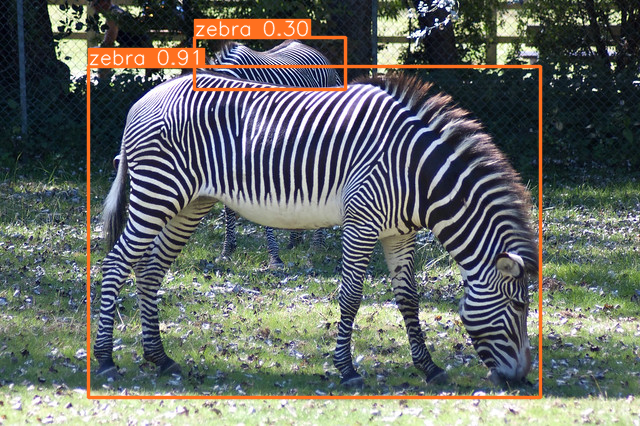

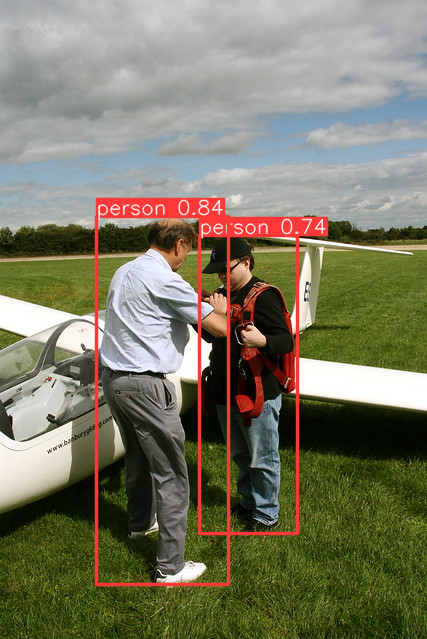

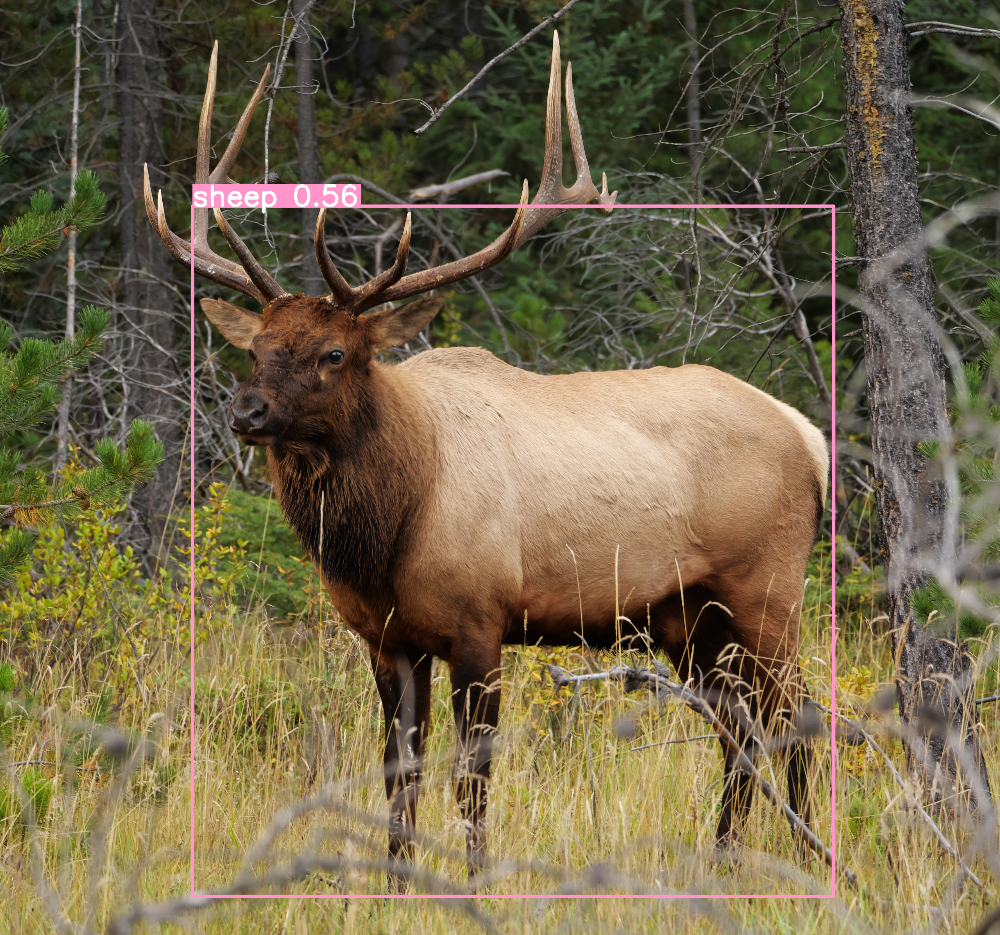

In [5]:
results.show()

In [ ]:
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
%pip install -qr requirements.txt comet_ml
%cd ..

In [13]:
!python3 yolov5/segment/predict.py --weights yolov5s-seg.pt --img 640 --conf 0.25 --source ./

segment/predict: weights=['yolov5s-seg.pt'], source=./, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/predict-seg, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1, retina_masks=False
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.11.6 torch-2.1.1 CPU

Fusing layers... 
YOLOv5s-seg summary: 224 layers, 7611485 parameters, 0 gradients, 26.4 GFLOPs
image 1/3 /Users/sema/github/object_detection2/elk.jpg: 608x640 1 sheep, 1 cow, 672.2ms
image 2/3 /Users/sema/github/object_detection2/peoples.jpeg: 640x448 2 persons, 1 car, 363.0ms
image 3/3 /Users/sema/github/object_detection2/zebra.jpeg: 448x640 1 zebra, 362.0ms
Speed: 0.6ms pre-process, 465.7ms inference, 1.7ms NMS per image at shape (1, 3, 640, 640

In [14]:
!python3 yolov5/detect.py --source 0

detect: weights=yolov5/yolov5s.pt, source=0, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.11.6 torch-2.1.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
2023-12-23 02:03:01.868 Python[7797:333410] WARNING: Secure coding is not enabled for restorable state! Enable secure coding by implementing NSApplicationDelegate.applicationSupportsSecureRestorableState: and returning YES.
1/1: 0...  Success (inf frames 1280x720 at 1.00 FPS)

0: 384x640 1 person, 248.0ms
0: 384x640 1 person, 206.9ms
0: 384x640 1 person, 220.1ms
0: 384x640 1 pe

In [10]:
modelseg = torch.hub.load(
    "ultralytics/yolov5", "custom", "yolov5m-seg.pt"
) 

Using cache found in /Users/sema/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2023-12-10 Python-3.11.6 torch-2.1.1 CPU

Fusing layers... 
YOLOv5m-seg summary: 301 layers, 21971597 parameters, 0 gradients, 70.8 GFLOPs
WARNING ⚠️ YOLOv5 SegmentationModel is not yet AutoShape compatible. You will not be able to run inference with this model.


In [8]:
# img = PIL.Image.open(imgs[0])

# im = torch.Tensor(torchvision.transforms.Compose([
#     torchvision.transforms.Resize((640, 640)),
#     torchvision.transforms.ToTensor(),
# ])(img))

im255 = torchvision.io.read_image(imgs[0])
im = im255.div(255)
im = torchvision.transforms.Resize((640, 640))(im)

print(im.shape)

inp = im.reshape(1, im.shape[0], im.shape[1], im.shape[2])



torch.Size([3, 640, 640])


In [11]:
res = modelseg(inp)



In [12]:
print(res[0].shape)
print(res[1].shape)
print(res[2][0].shape)

torchvision.transforms.ToPILImage()(res[1][0][31]).show()


torch.Size([1, 25200, 117])
torch.Size([1, 32, 160, 160])
torch.Size([1, 3, 80, 80, 117])
